In [1]:
%cd ..

/home/zengyun1/gnn/TMP_NN


/home/zengyun1/App/miniconda3/envs/gnn/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [2]:
!ls *

best_model.pth

0_Standardization:
BC.py			     MSC.py
Bergman_cyclization_std.xyz  Myers-Saito_cyclization_std.xyz
Bergman_cyclization.xyz      Myers-Saito_cyclization.xyz

1_Data_Generation:
elec  gaulog  spms  test.xyz  xyz2elec.sh  xyz2gaulog.sh  xyz2spms.sh

2_Training_testing:
training.ipynb	Untitled1.ipynb  Untitled.ipynb

3_Model_Explainability:

Dataset:
Bergman_cyclization.pkl  Myers-Saito_cyclization.pkl  README.MD

script:
Bergman_cyclization_gaulog.py  model.py				  __pycache__
elec.py			       Myers-Saito_cyclization_gaulog.py  spms.py


In [3]:
import numpy as np
import torch
import pickle
with open('Dataset/Bergman_cyclization.pkl', 'rb') as file:
    data_list = pickle.load(file)

In [67]:
data_list

[Data(x=[32, 47], edge_index=[2, 66], edge_attr=[66, 7], y=[1], pos=[32, 3], global_features=[13], x3d=[32, 8, 8, 8], x2d=[32, 10, 20], path='basisedy2_000_std', fragment=[3]),
 Data(x=[43, 47], edge_index=[2, 90], edge_attr=[90, 7], y=[1], pos=[43, 3], global_features=[13], x3d=[43, 8, 8, 8], x2d=[43, 10, 20], path='basisedy2_003_std', fragment=[3]),
 Data(x=[33, 47], edge_index=[2, 68], edge_attr=[68, 7], y=[1], pos=[33, 3], global_features=[13], x3d=[33, 8, 8, 8], x2d=[33, 10, 20], path='basisedy2_013_std', fragment=[3]),
 Data(x=[30, 47], edge_index=[2, 62], edge_attr=[62, 7], y=[1], pos=[30, 3], global_features=[13], x3d=[30, 8, 8, 8], x2d=[30, 10, 20], path='basisedy2_014_std', fragment=[3]),
 Data(x=[36, 47], edge_index=[2, 74], edge_attr=[74, 7], y=[1], pos=[36, 3], global_features=[13], x3d=[36, 8, 8, 8], x2d=[36, 10, 20], path='basisedy2_019_std', fragment=[3]),
 Data(x=[36, 47], edge_index=[2, 76], edge_attr=[76, 7], y=[1], pos=[36, 3], global_features=[13], x3d=[36, 8, 8, 8

In [71]:
from torch.utils.data import TensorDataset, DataLoader,random_split

def get_datalist(data_list,atom_list):
    data_size = len(data_list)
    
    x3d_total = torch.empty(data_size, atom_num, 8, 8, 8)  
    x2d_total = torch.empty(data_size, atom_num, 10, 20)
    x1d_total = torch.empty(data_size, atom_num, 23)
    x0d_total = torch.empty(data_size, 13)  # 
    y_total = torch.empty(data_size, 1)  
    for idx, G in enumerate(data_list):
        x3d_total[idx] = G.x3d[atom_list, :, :, :]
        x2d_total[idx] = G.x2d[atom_list, :, :]
        x1d_total[idx] = G.x[atom_list, :23]
        x0d_total[idx] = G.global_features

        # x0d_total[idx] = torch.cat((G.global_features[:1], G.global_features[3:]))
        y_total[idx] = G.y

    dataset = TensorDataset(x3d_total, x2d_total, x1d_total, x0d_total, y_total)
    return dataset

In [24]:
import torch
atom_list = [0,1,2,3,4,5]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)


In [25]:
from script.model import MultimodalMoleculeNet
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model=MultimodalMoleculeNet().to(device)
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
from torch.optim.lr_scheduler import StepLR
criterion = nn.MSELoss()
criterion2 = nn.L1Loss()
model=MultimodalMoleculeNet().to(device)

total_actuals = []
total_predictions = []

LR = 0.01

optimizer = optim.Adam(model.parameters(), lr=LR, weight_decay=1e-5)  # 定义优化器
scheduler = StepLR(optimizer, step_size=10, gamma=0.9)  # 定义学习率调度器
num_epochs = 1000

lr_list = []  # 列表来存储每个epoch的学习率
pbar = tqdm(range(num_epochs))

for epoch in pbar:
    model.train()  # 设置模型为训练模式
    running_loss = 0.0
    for x3d, x2d, x1d, x0d, targets  in train_dataloader:  # 假设我们只用x3d和targets进行训练
        x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
        
        optimizer.zero_grad()
        outputs = model(x3d,x2d,x1d)
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    
    avg_loss = running_loss / (2 * len(train_dataloader)) 

    scheduler.step()
    current_lr = optimizer.state_dict()['param_groups'][0]['lr']
    lr_list.append(current_lr)

    model.eval()
    total_val_loss = 0.0
    with torch.no_grad():
        for x3d, x2d, x1d, x0d, targets  in test_dataloader:
            x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
            outputs = model(x3d,x2d,x1d)
            loss = criterion(outputs, targets)
            total_val_loss += loss.item()

    avg_val_loss = total_val_loss / len(test_dataloader)
    pbar.set_postfix(dict(Training=f"{avg_loss:.1f}", Validation=f"{avg_val_loss:.1f}"))

    model.eval() 
    actuals = []
    predictions = []
    
    with torch.no_grad():
        for x3d,x2d,x1d,x0d, targets  in train_dataloader:
            x3d,x2d,x1d,x0d, targets = x3d.to(device),x2d.to(device),x1d.to(device),x0d.to(device),targets.to(device)
    
    
            outputs = model(x3d,x2d,x1d)
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())
    
    actuals = np.array(actuals)
    predictions = np.array(predictions)
    total_actuals.append(actuals)
    total_predictions.append(predictions)


100%|█████████| 1000/1000 [16:17<00:00,  1.02it/s, Training=2.4, Validation=8.1]


### zip

Animation size has reached 20992616 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


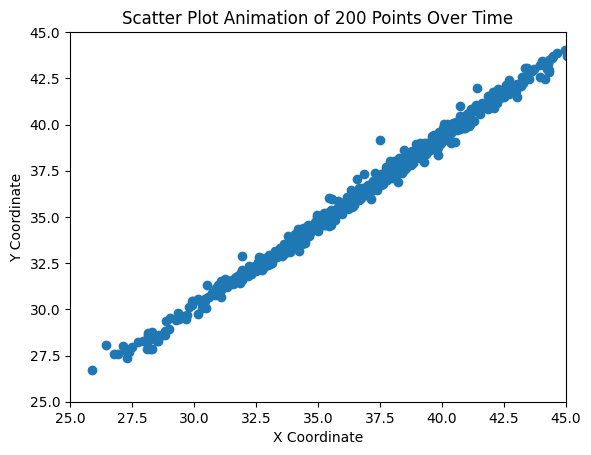

In [20]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# 假设 x 和 y 是你已有的两个变量，维度均为 (5000, 200)
# 在这里我们生成一些随机数据来模拟 x 和 y
x =  np.squeeze( np.array(total_actuals), axis=-1) 
y =  np.squeeze( np.array(total_predictions), axis=-1)  

# 创建图形和坐标轴
fig, ax = plt.subplots()
scat = ax.scatter(x[0], y[0])

# 设置坐标轴的范围，确保所有点都能显示
ax.set_xlim(25, 45)
ax.set_ylim(25, 45)
ax.set_xlabel('X Coordinate')
ax.set_ylabel('Y Coordinate')
ax.set_title('Scatter Plot Animation of 200 Points Over Time')

# 更新函数，用于更新每一帧的数据
def update(frame):
    scat.set_offsets(np.c_[x[frame], y[frame]])
    return scat,

# 创建动画，interval 参数控制每帧之间的间隔时间，单位为毫秒
ani = FuncAnimation(fig, update, frames=range(len(x)), interval=60, blit=False)

# 在 Jupyter Notebook 中显示动画
HTML(ani.to_jshtml())


In [12]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import CosineAnnealingLR
from torch.amp import GradScaler, autocast
from tqdm import tqdm
from sklearn.metrics import r2_score

# `torch.cuda.amp.GradScaler(args...)` is deprecated. 
# Please use `torch.amp.GradScaler('cuda', args...)` instead.


# 假设模型和数据加载器已经定义好
model=MultimodalMoleculeNet().to(device)
# train_dataloader = ...
# test_dataloader = ...
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

criterion = nn.MSELoss()
criterion2 = nn.L1Loss()

LR = 0.01
# optimizer = optim.AdamW(model.parameters(), lr=LR, weight_decay=1e-5)  # 改为 AdamW 优化器
# scheduler = CosineAnnealingLR(optimizer, T_max=500)  # 使用 CosineAnnealingLR 学习率调度器

optimizer = optim.Adam(model.parameters(), lr=LR, weight_decay=1e-5)  # 定义优化器
scheduler = StepLR(optimizer, step_size=10, gamma=0.9)  # 定义学习率调度器


num_epochs = 10000

scaler = GradScaler('cuda') 

lr_list = []  
best_val_loss = float('inf')
early_stopping_patience = 10000
no_improve_count = 0

pbar = tqdm(range(num_epochs))

for epoch in pbar:
    model.train() 
    running_loss = 0.0
    for x3d, x2d, x1d, x0d, targets in train_dataloader:  
        x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
        
        optimizer.zero_grad()

        with autocast('cuda'):  
            outputs = model(x3d, x2d, x1d)
            loss = criterion(outputs, targets)  

        scaler.scale(loss).backward() 
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0) 
        scaler.step(optimizer)
        scaler.update()

        running_loss += loss.item()

    avg_loss = running_loss / len(train_dataloader)
    scheduler.step()
    current_lr = optimizer.state_dict()['param_groups'][0]['lr']
    lr_list.append(current_lr)

    # 验证阶段
    model.eval()
    total_val_loss = 0.0
    preds_list = []
    targets_list = []
    with torch.no_grad():
        for x3d, x2d, x1d, x0d, targets in test_dataloader:
            x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
            outputs = model(x3d, x2d, x1d)
            loss = criterion(outputs, targets)
            total_val_loss += loss.item()

            preds_list.append(outputs.cpu().numpy())
            targets_list.append(targets.cpu().numpy())

    avg_val_loss = total_val_loss / len(test_dataloader)

    # R2 评分计算
    preds_array = np.concatenate(preds_list, axis=0)
    targets_array = np.concatenate(targets_list, axis=0)
    r2 = r2_score(targets_array, preds_array)

    # 更新早停机制
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        no_improve_count = 0
        torch.save(model.state_dict(), 'best_model.pth')  # 保存最优模型权重
        # print(f"Model improved, saving to 'best_model.pth'")
    else:
        no_improve_count += 1

    if no_improve_count >= early_stopping_patience:
        print(f"Validation loss hasn't improved in {early_stopping_patience} epochs. Stopping early.")
        break

    # 打印进度条信息
    pbar.set_postfix({
        'Train': f"{avg_loss:.2f}",
        'Test': f"{avg_val_loss:.2f}",
        'R2': f"{r2:.2f}",
        'LR': f"{current_lr*1000:.6f}"
    })

print("Training completed.")


100%|█| 10000/10000 [3:13:16<00:00,  1.16s/it, Train=22.80, Test=11.26, R2=0.35,

Training completed.


In [15]:
def model_Performance(dataloader):
    model.eval() 
    actuals = []
    predictions = []
    
    with torch.no_grad():
        for x3d,x2d,x1d,x0d, targets  in dataloader:
            x3d,x2d,x1d,x0d, targets = x3d.to(device),x2d.to(device),x1d.to(device),x0d.to(device),targets.to(device)
    
    
            outputs = model(x3d,x2d,x1d)
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())
    
    actuals = np.array(actuals)
    predictions = np.array(predictions)
    
    plt.figure(figsize=(10, 6))
    plt.scatter(actuals, predictions, alpha=0.5)
    plt.plot([actuals.min(), actuals.max()], [actuals.min(), actuals.max()], 'k--', lw=4)  
    plt.xlabel('Actual Values')
    plt.ylabel('Predictions')
    plt.title('Actual vs. Prediction')
    plt.show()
    
    errors = predictions - actuals
    plt.figure(figsize=(10, 6))
    plt.hist(errors, bins=25, edgecolor='k', alpha=0.6)
    plt.xlabel('Prediction Error')
    plt.ylabel('Count')
    plt.title('Prediction Error Distribution')
    plt.show()


In [ ]:
model_Performance(train_dataloader)

In [ ]:
model_Performance(test_dataloader)

### done

In [26]:
import torch
atom_list = [0,1,2,3,4,5,6,9]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)


In [27]:
from script.model import MultimodalMoleculeNet
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model=MultimodalMoleculeNet().to(device)
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
from torch.optim.lr_scheduler import StepLR
criterion = nn.MSELoss()
criterion2 = nn.L1Loss()
model=MultimodalMoleculeNet().to(device)

total_actuals = []
total_predictions = []

LR = 0.01

optimizer = optim.Adam(model.parameters(), lr=LR, weight_decay=1e-5)  # 定义优化器
scheduler = StepLR(optimizer, step_size=10, gamma=0.9)  # 定义学习率调度器
num_epochs = 1000

lr_list = []  # 列表来存储每个epoch的学习率
pbar = tqdm(range(num_epochs))

for epoch in pbar:
    model.train()  # 设置模型为训练模式
    running_loss = 0.0
    for x3d, x2d, x1d, x0d, targets  in train_dataloader:  # 假设我们只用x3d和targets进行训练
        x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
        
        optimizer.zero_grad()
        outputs = model(x3d,x2d,x1d)
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    
    avg_loss = running_loss / (2 * len(train_dataloader)) 

    scheduler.step()
    current_lr = optimizer.state_dict()['param_groups'][0]['lr']
    lr_list.append(current_lr)

    model.eval()
    total_val_loss = 0.0
    with torch.no_grad():
        for x3d, x2d, x1d, x0d, targets  in test_dataloader:
            x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
            outputs = model(x3d,x2d,x1d)
            loss = criterion(outputs, targets)
            total_val_loss += loss.item()

    avg_val_loss = total_val_loss / len(test_dataloader)
    pbar.set_postfix(dict(Training=f"{avg_loss:.1f}", Validation=f"{avg_val_loss:.1f}"))

    model.eval() 
    actuals = []
    predictions = []
    
    with torch.no_grad():
        for x3d,x2d,x1d,x0d, targets  in train_dataloader:
            x3d,x2d,x1d,x0d, targets = x3d.to(device),x2d.to(device),x1d.to(device),x0d.to(device),targets.to(device)
    
    
            outputs = model(x3d,x2d,x1d)
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())
    
    actuals = np.array(actuals)
    predictions = np.array(predictions)
    total_actuals.append(actuals)
    total_predictions.append(predictions)
    train_loss_list.append(avg_loss)
    val_loss_list.append(avg_val_loss)


100%|█████████| 1000/1000 [16:20<00:00,  1.02it/s, Training=2.0, Validation=7.0]


In [28]:
import torch
atom_list = [0,1,2,3,4,5,7,8]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)
from script.model import MultimodalMoleculeNet
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model=MultimodalMoleculeNet().to(device)
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
from torch.optim.lr_scheduler import StepLR
criterion = nn.MSELoss()
criterion2 = nn.L1Loss()
model=MultimodalMoleculeNet().to(device)

total_actuals = []
total_predictions = []

LR = 0.01

optimizer = optim.Adam(model.parameters(), lr=LR, weight_decay=1e-5)  # 定义优化器
scheduler = StepLR(optimizer, step_size=10, gamma=0.9)  # 定义学习率调度器
num_epochs = 1000

lr_list = []  # 列表来存储每个epoch的学习率
pbar = tqdm(range(num_epochs))

for epoch in pbar:
    model.train()  # 设置模型为训练模式
    running_loss = 0.0
    for x3d, x2d, x1d, x0d, targets  in train_dataloader:  # 假设我们只用x3d和targets进行训练
        x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
        
        optimizer.zero_grad()
        outputs = model(x3d,x2d,x1d)
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    
    avg_loss = running_loss / (2 * len(train_dataloader)) 

    scheduler.step()
    current_lr = optimizer.state_dict()['param_groups'][0]['lr']
    lr_list.append(current_lr)

    model.eval()
    total_val_loss = 0.0
    with torch.no_grad():
        for x3d, x2d, x1d, x0d, targets  in test_dataloader:
            x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
            outputs = model(x3d,x2d,x1d)
            loss = criterion(outputs, targets)
            total_val_loss += loss.item()

    avg_val_loss = total_val_loss / len(test_dataloader)
    pbar.set_postfix(dict(Training=f"{avg_loss:.1f}", Validation=f"{avg_val_loss:.1f}"))

    model.eval() 
    actuals = []
    predictions = []
    
    with torch.no_grad():
        for x3d,x2d,x1d,x0d, targets  in train_dataloader:
            x3d,x2d,x1d,x0d, targets = x3d.to(device),x2d.to(device),x1d.to(device),x0d.to(device),targets.to(device)
    
    
            outputs = model(x3d,x2d,x1d)
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())
    
    actuals = np.array(actuals)
    predictions = np.array(predictions)
    total_actuals.append(actuals)
    total_predictions.append(predictions)


100%|█████████| 1000/1000 [16:22<00:00,  1.02it/s, Training=2.3, Validation=8.3]


In [29]:
import torch
atom_list = [0,1,2,3,4,5,6,7,8,9]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)
from script.model import MultimodalMoleculeNet
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model=MultimodalMoleculeNet().to(device)
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
from torch.optim.lr_scheduler import StepLR
criterion = nn.MSELoss()
criterion2 = nn.L1Loss()
model=MultimodalMoleculeNet().to(device)

total_actuals = []
total_predictions = []

LR = 0.01

optimizer = optim.Adam(model.parameters(), lr=LR, weight_decay=1e-5)  # 定义优化器
scheduler = StepLR(optimizer, step_size=10, gamma=0.9)  # 定义学习率调度器
num_epochs = 1000

lr_list = []  # 列表来存储每个epoch的学习率
pbar = tqdm(range(num_epochs))

for epoch in pbar:
    model.train()  # 设置模型为训练模式
    running_loss = 0.0
    for x3d, x2d, x1d, x0d, targets  in train_dataloader:  # 假设我们只用x3d和targets进行训练
        x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
        
        optimizer.zero_grad()
        outputs = model(x3d,x2d,x1d)
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    
    avg_loss = running_loss / (2 * len(train_dataloader)) 

    scheduler.step()
    current_lr = optimizer.state_dict()['param_groups'][0]['lr']
    lr_list.append(current_lr)

    model.eval()
    total_val_loss = 0.0
    with torch.no_grad():
        for x3d, x2d, x1d, x0d, targets  in test_dataloader:
            x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
            outputs = model(x3d,x2d,x1d)
            loss = criterion(outputs, targets)
            total_val_loss += loss.item()

    avg_val_loss = total_val_loss / len(test_dataloader)
    pbar.set_postfix(dict(Training=f"{avg_loss:.1f}", Validation=f"{avg_val_loss:.1f}"))

    model.eval() 
    actuals = []
    predictions = []
    
    with torch.no_grad():
        for x3d,x2d,x1d,x0d, targets  in train_dataloader:
            x3d,x2d,x1d,x0d, targets = x3d.to(device),x2d.to(device),x1d.to(device),x0d.to(device),targets.to(device)
    
    
            outputs = model(x3d,x2d,x1d)
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())
    
    actuals = np.array(actuals)
    predictions = np.array(predictions)
    total_actuals.append(actuals)
    total_predictions.append(predictions)


100%|█████████| 1000/1000 [16:34<00:00,  1.01it/s, Training=2.4, Validation=6.1]


In [72]:
import torch
atom_list = [6,0,1,2,7,8,3,4,5,9]
atom_num = len(atom_list)
dataset = get_datalist(data_list,atom_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)
from script.model import MultimodalMoleculeNet
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model=MultimodalMoleculeNet().to(device)
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
from torch.optim.lr_scheduler import StepLR
criterion = nn.MSELoss()
criterion2 = nn.L1Loss()
model=MultimodalMoleculeNet().to(device)

total_actuals = []
total_predictions = []

LR = 0.01

optimizer = optim.Adam(model.parameters(), lr=LR, weight_decay=1e-5)  # 定义优化器
scheduler = StepLR(optimizer, step_size=10, gamma=0.9)  # 定义学习率调度器
num_epochs = 1000

lr_list = []  # 列表来存储每个epoch的学习率
pbar = tqdm(range(num_epochs))

for epoch in pbar:
    model.train()  # 设置模型为训练模式
    running_loss = 0.0
    for x3d, x2d, x1d, x0d, targets  in train_dataloader:  # 假设我们只用x3d和targets进行训练
        x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
        
        optimizer.zero_grad()
        outputs = model(x3d,x2d,x1d)
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    
    avg_loss = running_loss / (2 * len(train_dataloader)) 

    scheduler.step()
    current_lr = optimizer.state_dict()['param_groups'][0]['lr']
    lr_list.append(current_lr)

    model.eval()
    total_val_loss = 0.0
    with torch.no_grad():
        for x3d, x2d, x1d, x0d, targets  in test_dataloader:
            x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
            outputs = model(x3d,x2d,x1d)
            loss = criterion(outputs, targets)
            total_val_loss += loss.item()

    avg_val_loss = total_val_loss / len(test_dataloader)
    pbar.set_postfix(dict(Training=f"{avg_loss:.1f}", Validation=f"{avg_val_loss:.1f}"))

    model.eval() 
    actuals = []
    predictions = []
    
    with torch.no_grad():
        for x3d,x2d,x1d,x0d, targets  in train_dataloader:
            x3d,x2d,x1d,x0d, targets = x3d.to(device),x2d.to(device),x1d.to(device),x0d.to(device),targets.to(device)
    
    
            outputs = model(x3d,x2d,x1d)
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())
    
    actuals = np.array(actuals)
    predictions = np.array(predictions)
    total_actuals.append(actuals)
    total_predictions.append(predictions)


 22%|██▏       | 223/1000 [04:01<14:02,  1.08s/it, Training=3.9, Validation=6.8]


KeyboardInterrupt: 

In [69]:
def train_and_test(atom_list,dataset):
    
    atom_num = len(atom_list)
    dataset = get_datalist(data_list)
    
    train_size = int(0.80 * len(dataset))
    test_size = len(dataset) - train_size
    
    torch.manual_seed(2025)
    # Randomly partition the data set
    train_dataset, test_dataset = random_split(dataset, [train_size, test_size])
    
    
    train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
    test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)

    criterion = nn.MSELoss()
    criterion2 = nn.L1Loss()
    model=MultimodalMoleculeNet().to(device)
    
    total_actuals = []
    total_predictions = []
    train_loss_list = []
    val_loss_list = []
    LR = 0.01
    
    optimizer = optim.Adam(model.parameters(), lr=LR, weight_decay=1e-5)  # 定义优化器
    scheduler = StepLR(optimizer, step_size=10, gamma=0.9)  # 定义学习率调度器
    num_epochs = 1000
    
    lr_list = []  # 列表来存储每个epoch的学习率
    pbar = tqdm(range(num_epochs))
    
    for epoch in pbar:
        model.train()  # 设置模型为训练模式
        running_loss = 0.0
        for x3d, x2d, x1d, x0d, targets  in train_dataloader:  # 假设我们只用x3d和targets进行训练
            x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
            
            optimizer.zero_grad()
            outputs = model(x3d,x2d,x1d)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
        
        avg_loss = running_loss / (2 * len(train_dataloader)) 
    
        scheduler.step()
        current_lr = optimizer.state_dict()['param_groups'][0]['lr']
        lr_list.append(current_lr)
    
        model.eval()
        total_val_loss = 0.0
        with torch.no_grad():
            for x3d, x2d, x1d, x0d, targets  in test_dataloader:
                x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
                outputs = model(x3d,x2d,x1d)
                loss = criterion(outputs, targets)
                total_val_loss += loss.item()
    
        avg_val_loss = total_val_loss / len(test_dataloader)
        pbar.set_postfix(dict(Training=f"{avg_loss:.1f}", Validation=f"{avg_val_loss:.1f}"))
    
        model.eval() 
        actuals = []
        predictions = []
        
        with torch.no_grad():
            for x3d,x2d,x1d,x0d, targets  in train_dataloader:
                x3d,x2d,x1d,x0d, targets = x3d.to(device),x2d.to(device),x1d.to(device),x0d.to(device),targets.to(device)
        
        
                outputs = model(x3d,x2d,x1d)
                actuals.extend(targets.cpu().numpy())
                predictions.extend(outputs.cpu().numpy())
        
        actuals = np.array(actuals)
        predictions = np.array(predictions)
        total_actuals.append(actuals)
        total_predictions.append(predictions)
        train_loss_list.append(avg_loss)
        val_loss_list.append(avg_val_loss)

    return model,[train_loss_list,val_loss_list],[total_actuals,total_predictions]

In [70]:
import torch
atom_list = [0,2,3,5]

model0,[train_loss_list0,val_loss_list0],[total_actuals0,total_predictions0] = train_and_test(atom_list)

RuntimeError: The expanded size of the tensor (6) must match the existing size (4) at non-singleton dimension 0.  Target sizes: [6, 8, 8, 8].  Tensor sizes: [4, 8, 8, 8]

In [33]:
import torch
atom_list = [0,1,4,5]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)
model1,[train_loss_list1,val_loss_list1],[total_actuals1,total_predictions1] = train_and_test(train_dataloader,test_dataloader)

100%|█████████| 1000/1000 [16:33<00:00,  1.01it/s, Training=1.8, Validation=6.7]


In [34]:
import torch
atom_list = [0,1,2,3,4,5]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)
model2,[train_loss_list2,val_loss_list2],[total_actuals2,total_predictions2] = train_and_test(train_dataloader,test_dataloader)

100%|█████████| 1000/1000 [17:05<00:00,  1.03s/it, Training=2.1, Validation=6.9]


In [68]:
import torch
atom_list = [0,1,2,3,4,5]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)
model3,[train_loss_list3,val_loss_list3],[total_actuals3,total_predictions3] = train_and_test(train_dataloader,test_dataloader)

  1%|▏        | 14/1000 [00:16<18:56,  1.15s/it, Training=39.5, Validation=26.5]


KeyboardInterrupt: 

In [36]:
import torch
atom_list = [6,0,1,2,3,4,5,9]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)
model4,[train_loss_list4,val_loss_list4],[total_actuals4,total_predictions4] = train_and_test(train_dataloader,test_dataloader)

100%|█████████| 1000/1000 [16:53<00:00,  1.01s/it, Training=1.9, Validation=6.6]


In [37]:
import torch
atom_list = [0,1,2,7,8,3,4,5]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)
model5,[train_loss_list5,val_loss_list5],[total_actuals5,total_predictions5] = train_and_test(train_dataloader,test_dataloader)

100%|█████████| 1000/1000 [16:52<00:00,  1.01s/it, Training=2.0, Validation=6.1]


In [38]:
import torch
atom_list = [6,0,1,2,7,8,3,4,5,9]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)
model6,[train_loss_list6,val_loss_list6],[total_actuals6,total_predictions6] = train_and_test(train_dataloader,test_dataloader)

100%|█████████| 1000/1000 [16:56<00:00,  1.02s/it, Training=1.9, Validation=6.6]


In [ ]:
import torch
atom_list = [0,1,2,3,4,5,6,7,8,9]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)
model7,[train_loss_list7,val_loss_list7],[total_actuals7,total_predictions7] = train_and_test(train_dataloader,test_dataloader)

In [39]:
atom_list = [5,3,2,1,0,4]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)
model8,[train_loss_list8,val_loss_list8],[total_actuals8,total_predictions8] = train_and_test(train_dataloader,test_dataloader)

100%|████████| 1000/1000 [16:45<00:00,  1.01s/it, Training=2.5, Validation=10.2]


In [40]:
atom_list = [5,2,2,1,3,4]
atom_num = len(atom_list)
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)
model9,[train_loss_list9,val_loss_list9],[total_actuals9,total_predictions9] = train_and_test(train_dataloader,test_dataloader)

 10%|▊       | 101/1000 [01:45<15:39,  1.04s/it, Training=10.1, Validation=13.3]


KeyboardInterrupt: 

In [50]:
import matplotlib.pyplot as plt
def plottt(train_loss_list,val_loss_list):
    plt.figure()
    plt.plot(train_loss_list, label='Training Loss')
    plt.plot(val_loss_list, label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss over Epochs')
    plt.legend()
    plt.show()

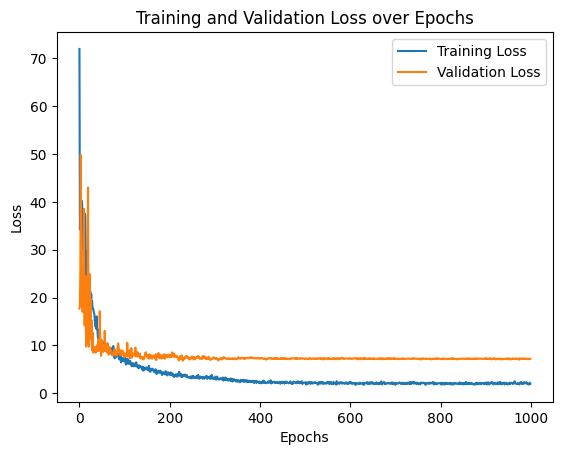

In [51]:
plottt(train_loss_list0,val_loss_list0)

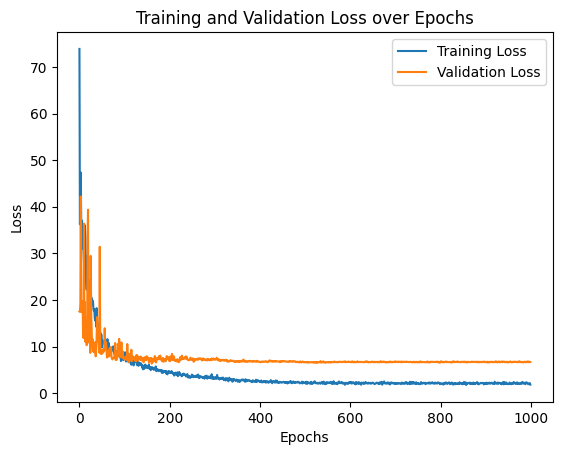

In [52]:
plottt(train_loss_list1,val_loss_list1)

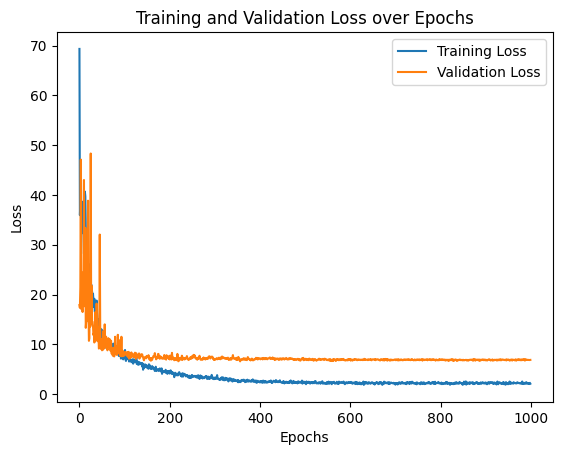

In [53]:
plottt(train_loss_list2,val_loss_list2)

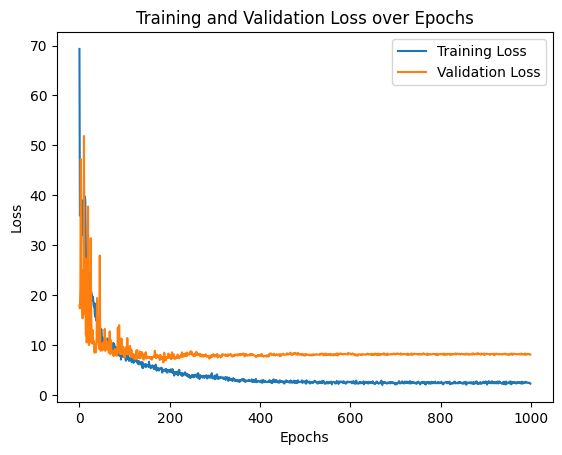

In [54]:
plottt(train_loss_list3,val_loss_list3)

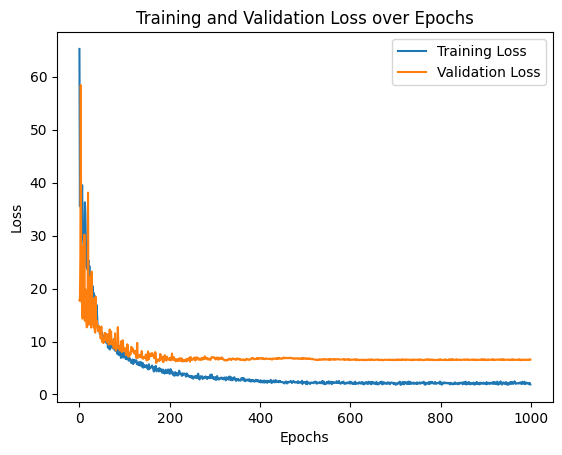

In [55]:
plottt(train_loss_list4,val_loss_list4)

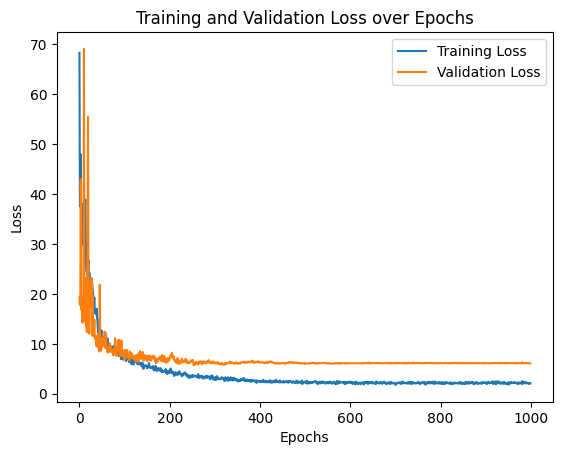

In [56]:
plottt(train_loss_list5,val_loss_list5)

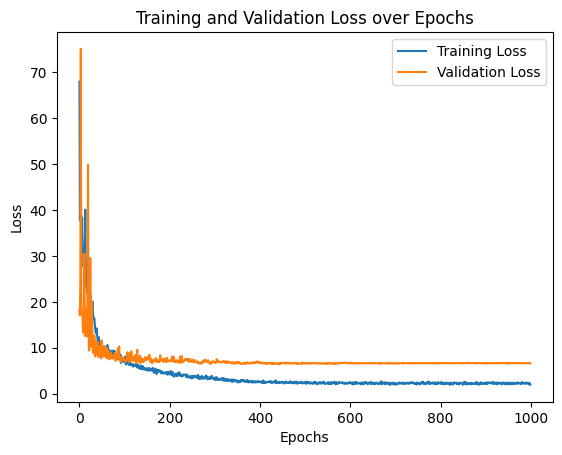

In [57]:
plottt(train_loss_list6,val_loss_list6)

In [59]:
def model_Performance(dataloader,model):
    model.eval() 
    actuals = []
    predictions = []
    
    with torch.no_grad():
        for x3d,x2d,x1d,x0d, targets  in dataloader:
            x3d,x2d,x1d,x0d, targets = x3d.to(device),x2d.to(device),x1d.to(device),x0d.to(device),targets.to(device)
    
    
            outputs = model(x3d,x2d,x1d)
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())
    
    actuals = np.array(actuals)
    predictions = np.array(predictions)
    
    plt.figure(figsize=(10, 6))
    plt.scatter(actuals, predictions, alpha=0.5)
    plt.plot([actuals.min(), actuals.max()], [actuals.min(), actuals.max()], 'k--', lw=4)  
    plt.xlabel('Actual Values')
    plt.ylabel('Predictions')
    plt.title('Actual vs. Prediction')
    plt.show()
    
    errors = predictions - actuals
    plt.figure(figsize=(10, 6))
    plt.hist(errors, bins=25, edgecolor='k', alpha=0.6)
    plt.xlabel('Prediction Error')
    plt.ylabel('Count')
    plt.title('Prediction Error Distribution')
    plt.show()


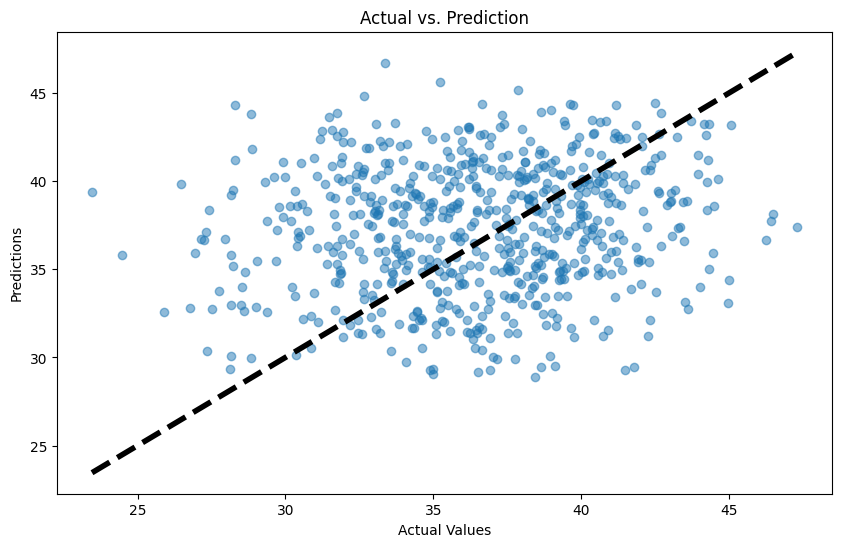

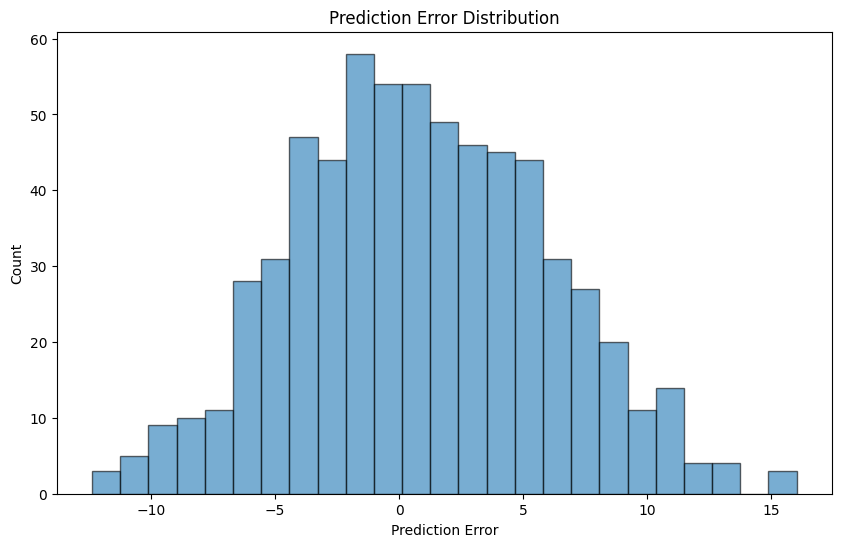

In [76]:
model_Performance(train_dataloader,model3)